# 漫画雑誌データの可視化

再実行には[マンガと学ぶデータビジュアライゼーションの環境構築](https://kakeami.github.io/viz-madb/appendix/setup.html)によって作成される`episodes.csv`が必要です

In [1]:
import itertools
import pandas as pd
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

In [2]:
# 前処理の結果，以下に分析対象ファイルが格納されていることを想定
PATH_DATA = '../../data/preprocess/out/episodes.csv'
# Jupyter Book用のPlotlyのrenderer
RENDERER = 'plotly_mimetype+notebook'

In [3]:
def show_fig(fig):
    """Jupyter Bookでも表示可能なようRendererを指定"""
    fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
    fig.show(renderer=RENDERER)

In [4]:
def add_years_to_df(df, unit_years=10):
    """unit_years単位で区切ったyears列を追加"""
    df_new = df.copy()
    df_new['years'] = \
        pd.to_datetime(df['datePublished']).dt.year \
        // unit_years * unit_years
    df_new['years'] = df_new['years'].astype(str)
    return df_new

In [5]:
def resample_df_by_creator_and_years(df):
    """creatorとyearsのすべての組み合わせが存在するように0埋め
    この処理を実施しないと作図時にX軸方向の順序が変わってしまう"""
    df_new = df.copy()
    yearss = df['years'].unique()
    creators = df['creator'].unique()
    for creator, years in itertools.product(creators, yearss):
        df_tmp = df_new[
            (df_new['creator'] == creator)&\
            (df_new['years'] == years)]
        if df_tmp.shape[0] == 0:
            s = pd.Series(
                {'creator': creator,
                 'years': years,
                 'weeks': 0,},
                index=df_tmp.columns)
            df_new = df_new.append(
                s, ignore_index=True)
    return df_new

In [6]:
df = pd.read_csv(PATH_DATA)

## 1. 週刊少年ジャンプの作品別の掲載週数を表した棒グラフ

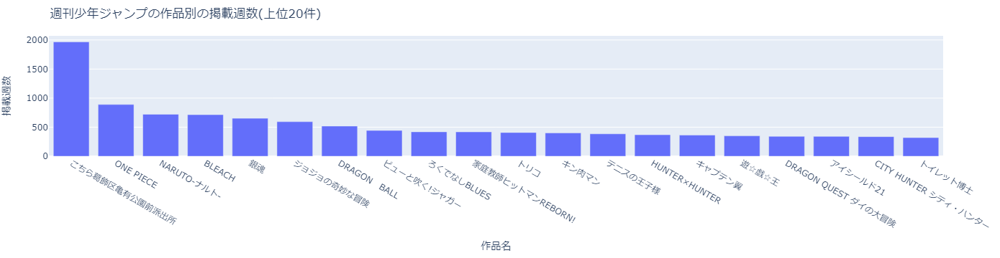

In [7]:
df_jump = df.query('mcname == "週刊少年ジャンプ"')
df_plot = df_jump.value_counts('cname').reset_index(name='weeks').head(20)
fig = px.bar(df_plot, x='cname', y='weeks', 
             title='週刊少年ジャンプの作品別の掲載週数(上位20件)')
fig.update_xaxes(title='作品名')
fig.update_yaxes(title='掲載週数')
show_fig(fig)

## 2. 週刊少年マガジンの掲載年別・作家別に掲載週数の多さを表したヒートマップ

In [8]:
# 10年単位で区切ったyearsを追加
df_magazine = df.query('mcname == "週刊少年マガジン"')
df_magazine = add_years_to_df(df_magazine, 1)

In [9]:
# プロット用に集計
df_plot = \
    df_magazine.groupby('creator')['years'].value_counts().\
    reset_index(name='weeks')
# 連載週刊上位10作品を抽出
creators = list(df_magazine.value_counts('creator').head(20).index)
df_plot = df_plot[df_plot['creator'].isin(creators)].\
    reset_index(drop=True)
# 作図用に空白期間を0埋め
df_plot = \
    resample_df_by_creator_and_years(df_plot)

In [10]:
# 合計連載週数で降順ソート
df_plot['order'] = df_plot['creator'].apply(
    lambda x: creators.index(x))
df_plot = df_plot.sort_values(
    ['order', 'years'], ignore_index=True)

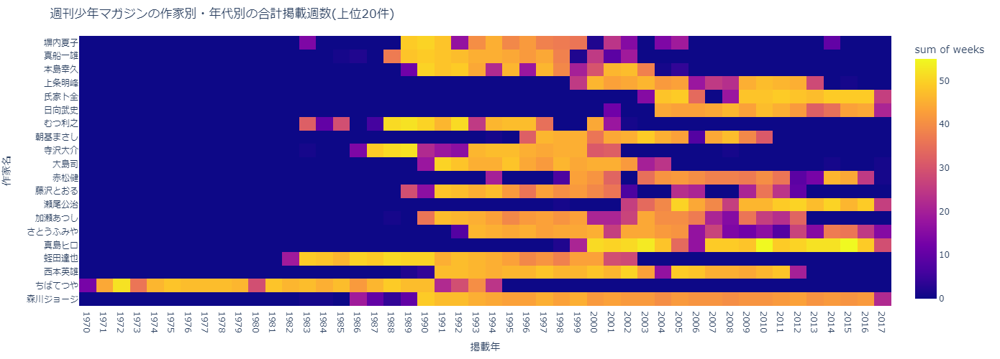

In [11]:
fig = px.density_heatmap(
    df_plot, x='years', y='creator', z='weeks',
    title='週刊少年マガジンの作家別・年代別の合計掲載週数(上位20件)', height=500)
fig.update_xaxes(title='掲載年')
fig.update_yaxes(title='作家名')
show_fig(fig)

## 3. 週刊少年チャンピオンのマンガ作品ごとの平均掲載位置の分布を表したヒストグラム

In [12]:
# 平均掲載位置を算出する際の最小連載数
MIN_WEEKS = 5

In [13]:
df_champion = df.query('mcname == "週刊少年チャンピオン"')
df_plot = \
    df_champion.groupby(['mcname', 'cname', 'creator'])['pageStartPosition']\
    .agg(['count', 'mean']).reset_index()
df_plot = df_plot[df_plot['count'] >= MIN_WEEKS]\
    .reset_index(drop=True)

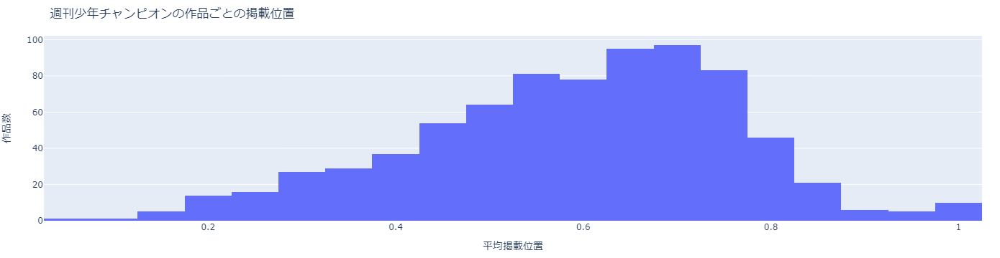

In [14]:
fig = px.histogram(
    df_plot, x='mean', title='週刊少年チャンピオンの作品ごとの掲載位置')
fig.update_xaxes(title='平均掲載位置')
fig.update_yaxes(title='作品数')
show_fig(fig)

## 4. 週刊少年ジャンプの作品ごとの掲載位置の分布を示した箱ひげ図

In [15]:
df_tmp = \
    df_jump.groupby('cname')['pageStartPosition']\
    .agg(['count', 'mean']).reset_index()
df_tmp = \
    df_tmp.sort_values('count', ascending=False, ignore_index=True)\
    .head(10)
cname2position = df_tmp.groupby('cname')['mean'].first().to_dict()

In [16]:
df_plot = df_jump[df_jump['cname'].isin(list(cname2position.keys()))]\
    .reset_index(drop=True)
df_plot['position'] = df_plot['cname'].apply(
    lambda x: cname2position[x])
df_plot = df_plot.sort_values('position', ignore_index=True)

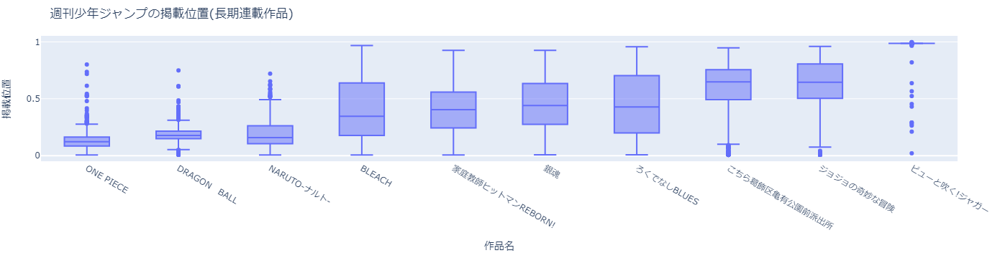

In [17]:
fig = px.box(
    df_plot, x='cname', y='pageStartPosition',
    title='週刊少年ジャンプの掲載位置(長期連載作品)')
fig.update_xaxes(title='作品名')
fig.update_yaxes(title='掲載位置')
show_fig(fig)

## 5. 雑誌ごとの合計作品数の比率を表した円グラフ

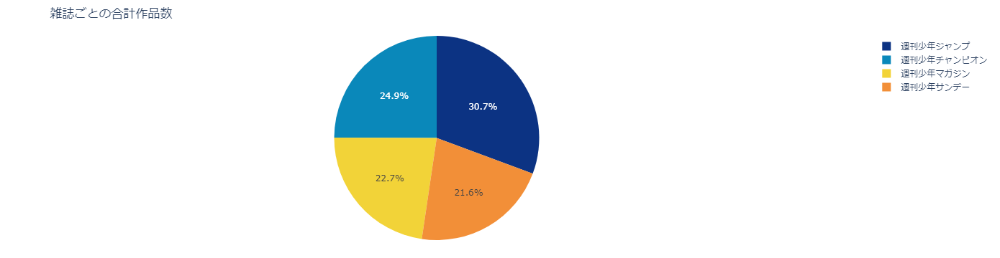

In [18]:
df_plot = \
    df.groupby('mcname')['cname'].nunique().reset_index()
df_plot = \
    df_plot.sort_values(
    'cname', ascending=False, ignore_index=True)
fig = px.pie(
    df_plot, values='cname', names='mcname',
    color_discrete_sequence= px.colors.diverging.Portland,
    title='雑誌ごとの合計作品数')
show_fig(fig)

## 6. 雑誌別・作品別の掲載週数の割合を表現したツリーマップ

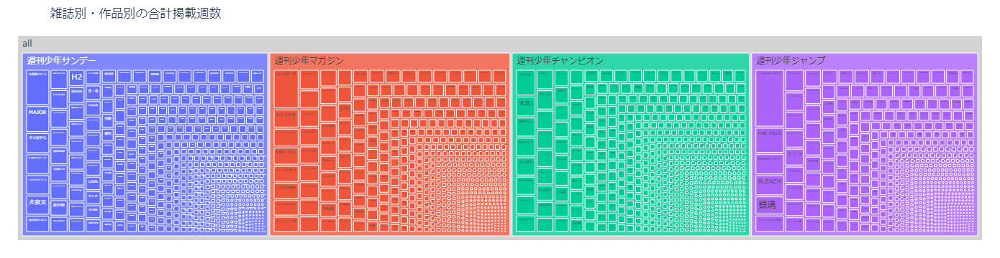

In [19]:
df_plot = \
    df.groupby('mcname')['cname'].value_counts().\
    reset_index(name='weeks')
# 描画用に10週以上の作品に絞る
df_plot = df_plot[df_plot['weeks']>=10].reset_index(drop=True)
fig = px.treemap(
    df_plot, path=[px.Constant('all'), 'mcname', 'cname'],
    values='weeks', title='雑誌別・作品別の合計掲載週数')
fig.update_traces(root_color='lightgrey')
show_fig(fig)

## 7. 平均掲載位置（横方向の位置、掲載週数（縦方向の位置)、雑誌（ドットの色）を表した散布図

In [20]:
df_plot = \
    df.groupby(['mcname', 'cname'])['pageStartPosition'].\
    agg(['count', 'mean']).reset_index()
df_plot.columns = ['mcname', 'cname', 'weeks', 'position']
df_plot = \
    df_plot[df_plot['weeks'] >= MIN_WEEKS].reset_index(drop=True)

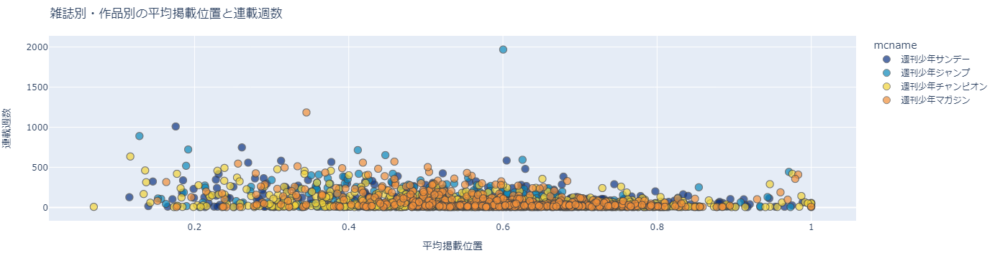

In [21]:
fig = px.scatter(
    df_plot, x='position', y='weeks', color='mcname', 
    opacity=0.7,
    hover_data=['cname'], 
    color_discrete_sequence= px.colors.diverging.Portland,
    title='雑誌別・作品別の平均掲載位置と連載週数')
fig.update_traces(
    marker={'size': 10, 'line_width':1})
fig.update_xaxes(title='平均掲載位置')
fig.update_yaxes(title='連載週数')
show_fig(fig)

## 8. 雑誌の価格の推移を表した折れ線グラフ

In [22]:
df_drop = df.drop_duplicates(subset='miid')

In [23]:
df_drop['datePublished'] = pd.to_datetime(df_drop['datePublished'])

In [24]:
df_drop = \
    df_drop.sort_values(['datePublished'], ignore_index=True)

In [25]:
mcnames = df_drop['mcname'].unique()

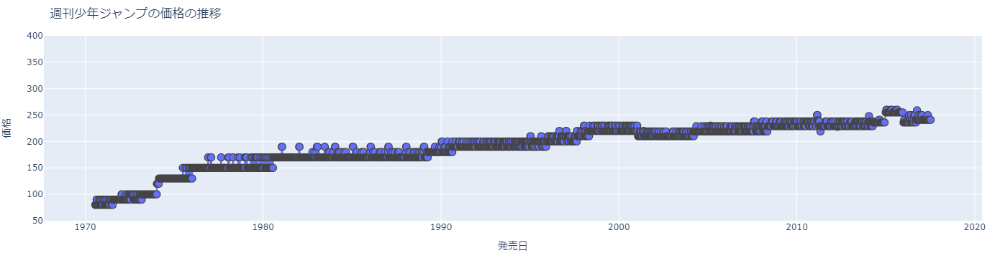

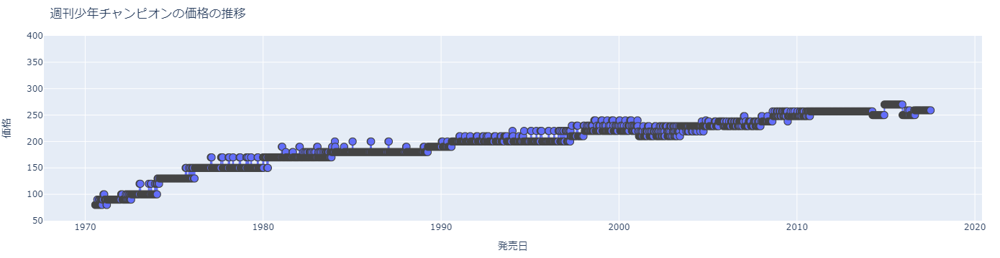

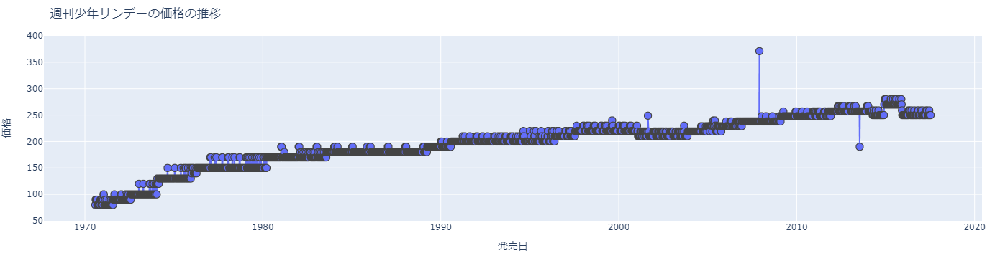

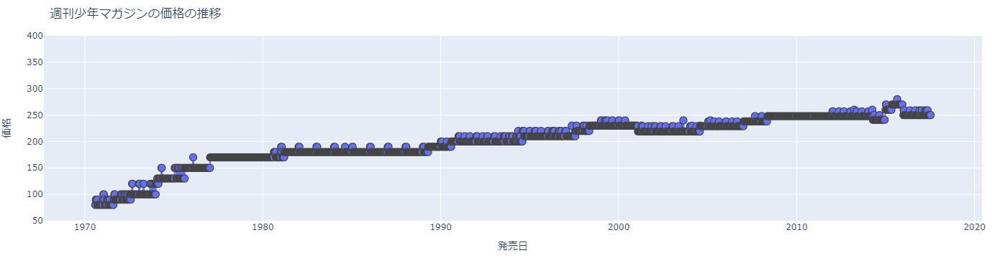

In [26]:
for mcname in mcnames:
    df_c = df_drop[df_drop['mcname']==mcname].reset_index(drop=True)
    fig = px.line(
        df_c, x='datePublished', y='price',
        hover_data=['miname'], title=f'{mcname}の価格の推移')
    fig.update_traces(
        mode='lines+markers',
        marker=dict(line_width=1, size=10))
    fig.update_xaxes(title='発売日')
    fig.update_yaxes(title='価格', range=[50, 400])
    fig.update_layout(hovermode='x unified')
    show_fig(fig)